<a href="https://colab.research.google.com/drive/1wvpTW3zX_w_aHUzIjTjLL3N2i8fmHld3#scrollTo=6PmlFlc6QU_N"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## <h1 align="center"> DS510: AI/ML - Lab</h1>
<h1 align="center">⛳ Mini Project 01</h1>

---
<font color="lightgreen">**Name:** Shivam<br>
**Roll No:** 12241710</font>

# Multilingual Image Captioning and Speech Synthesis

## Project Overview

In this project, we build a **multilingual assistive model** that helps visually impaired users by automatically generating textual descriptions of images and providing audio narrations in multiple Indian languages. The model employs state-of-the-art deep learning architectures, including **`Vision Transformers (ViT)`** for image captioning, **`IndicTrans2`** for language translation, and **`gTTS`** for converting text to speech.

### Key Features:

- **Image Captioning**: Using a `pre-trained Vision Transformer`, the model generates accurate captions for uploaded images.
- **Multilingual Support**: The captions are translated into a variety of Indian languages using the `IndicTrans2` model.
- **Text-to-Speech (TTS)**: Translated captions are converted to speech using Google's TTS service `gTTS`, enabling users to hear the description of the image in their chosen language.

This tool serves as an aid for users with visual impairments by transforming visual content into comprehensible and accessible audio outputs in their preferred language.




Here is the list of languages supported by the `IndicTrans2` models:

| Language                       | Code      | Language                        | Code      | Language                       | Code      |
|--------------------------------|-----------|---------------------------------|-----------|--------------------------------|-----------|
| Assamese                       | asm_Beng  | Kashmiri (Arabic)               | kas_Arab  | Punjabi                        | pan_Guru  |
| Bengali                        | ben_Beng  | Kashmiri (Devanagari)           | kas_Deva  | Sanskrit                       | san_Deva  |
| Bodo                           | brx_Deva  | Maithili                        | mai_Deva  | Santali                        | sat_Olck  |
| Dogri                          | doi_Deva  | Malayalam                       | mal_Mlym  | Sindhi (Arabic)                | snd_Arab  |
| English                        | eng_Latn  | Marathi                         | mar_Deva  | Sindhi (Devanagari)            | snd_Deva  |
| Konkani                        | gom_Deva  | Manipuri (Bengali)              | mni_Beng  | Tamil                          | tam_Taml  |
| Gujarati                       | guj_Gujr  | Manipuri (Meitei)               | mni_Mtei  | Telugu                         | tel_Telu  |
| Hindi                          | hin_Deva  | Nepali                          | npi_Deva  | Urdu                           | urd_Arab  |
| Kannada                        | kan_Knda  | Odia                            | ory_Orya  |                                |           |

`gTTS` supports the following Indic languages:

| Language  | Code |
|-----------|------|
| Hindi     | hi   |
| Bengali   | bn   |
| Gujarati  | gu   |
| Kannada   | kn   |
| Malayalam | ml   |
| Marathi   | mr   |
| Tamil     | ta   |
| Telugu    | te   |
| Punjabi   | pa   |


# Getting Started

Image captioning involves translating an image into a textual description. We use Vision Transformers (ViT) and PyTorch backend. The article and code demonstrates using trained models without retraining from scratch to generate image captions.

# IndicTrans2 HF Inference

> We provide an example notebook on how to use our IndicTrans2 models which were originally trained with the fairseq to HuggingFace transformers for inference purpose.


## Setup

Please run the cells below to install the necessary dependencies.


In [1]:
%%capture
!git clone https://github.com/AI4Bharat/IndicTrans2.git

In [2]:
%%capture
%cd /content/IndicTrans2/huggingface_interface

In [3]:
%%capture
!python3 -m pip install nltk sacremoses pandas regex mock transformers>=4.33.2 mosestokenizer
!python3 -c "import nltk; nltk.download('punkt')"
!python3 -m pip install bitsandbytes scipy accelerate datasets
!python3 -m pip install sentencepiece

!git clone https://github.com/VarunGumma/IndicTransToolkit.git
%cd IndicTransToolkit
!python3 -m pip install --editable ./
%cd ..

**IMPORTANT : Restart your run-time first and then run the cells below.**

# Importing Required Libraries

In [25]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
# Installing Transformer Libraries
!pip install transformers

In [5]:
# Web links Handler
import requests

# Backend
import torch

# Image Processing
from PIL import Image

# Transformer and Pretrained Model
from transformers import VisionEncoderDecoderModel, ViTImageProcessor, GPT2TokenizerFast

# Managing loading processsing
from tqdm import tqdm

# Assign available GPU
device = "cuda" if torch.cuda.is_available() else "cpu"

In [6]:
#  Image media display
from IPython.display import display
from PIL import Image
import requests
import os

# Using a Trained Model

In [7]:
# Loading a fine-tuned image captioning Transformer Model

# ViT Encoder - Decoder Model
model = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning").to(device)

# Corresponding ViT Tokenizer
tokenizer = GPT2TokenizerFast.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

# Image processor
image_processor = ViTImageProcessor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


# Preparing Image Data

Preparing image for capturing

In [8]:
# Accesssing images from the web
import urllib.parse as parse
import os
# Verify url
def check_url(string):
    try:
        result = parse.urlparse(string)
        return all([result.scheme, result.netloc, result.path])
    except:
        return False

# Load an image
def load_image(image_path):
    if check_url(image_path):
        return Image.open(requests.get(image_path, stream=True).raw)
    elif os.path.exists(image_path):
        return Image.open(image_path)

# Image Captioning Model with `ViT`




In [9]:
# Image inference
def get_caption(model, image_processor, tokenizer, image_path):
    image = load_image(image_path)

    # Preprocessing the Image
    img = image_processor(image, return_tensors="pt").to(device)

    # Generating captions
    output = model.generate(**img)

    # decode the output
    caption = tokenizer.batch_decode(output, skip_special_tokens=True)[0]

    return caption

# Translating Captions with IndicTrans2

## Inference


In [10]:
import torch
from transformers import AutoModelForSeq2SeqLM, BitsAndBytesConfig, AutoTokenizer
from IndicTransToolkit import IndicProcessor

BATCH_SIZE = 4
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
quantization = None

In [11]:
def initialize_model_and_tokenizer(ckpt_dir, quantization):
    if quantization == "4-bit":
        qconfig = BitsAndBytesConfig(
            load_in_4bit=True,
            bnb_4bit_use_double_quant=True,
            bnb_4bit_compute_dtype=torch.bfloat16,
        )
    elif quantization == "8-bit":
        qconfig = BitsAndBytesConfig(
            load_in_8bit=True,
            bnb_8bit_use_double_quant=True,
            bnb_8bit_compute_dtype=torch.bfloat16,
        )
    else:
        qconfig = None

    tokenizer = AutoTokenizer.from_pretrained(ckpt_dir, trust_remote_code=True)
    model = AutoModelForSeq2SeqLM.from_pretrained(
        ckpt_dir,
        trust_remote_code=True,
        low_cpu_mem_usage=True,
        quantization_config=qconfig,
    )

    if qconfig == None:
        model = model.to(DEVICE)
        if DEVICE == "cuda":
            model.half()

    model.eval()

    return tokenizer, model


def batch_translate(input_sentences, src_lang, tgt_lang, model, tokenizer, ip):
    translations = []
    for i in range(0, len(input_sentences), BATCH_SIZE):
        batch = input_sentences[i : i + BATCH_SIZE]

        # Preprocess the batch and extract entity mappings
        batch = ip.preprocess_batch(batch, src_lang=src_lang, tgt_lang=tgt_lang)

        # Tokenize the batch and generate input encodings
        inputs = tokenizer(
            batch,
            truncation=True,
            padding="longest",
            return_tensors="pt",
            return_attention_mask=True,
        ).to(DEVICE)

        # Generate translations using the model
        with torch.no_grad():
            generated_tokens = model.generate(
                **inputs,
                use_cache=True,
                min_length=0,
                max_length=256,
                num_beams=5,
                num_return_sequences=1,
            )

        # Decode the generated tokens into text

        with tokenizer.as_target_tokenizer():
            generated_tokens = tokenizer.batch_decode(
                generated_tokens.detach().cpu().tolist(),
                skip_special_tokens=True,
                clean_up_tokenization_spaces=True,
            )

        # Postprocess the translations, including entity replacement
        translations += ip.postprocess_batch(generated_tokens, lang=tgt_lang)

        del inputs
        torch.cuda.empty_cache()

    return translations

### English to Indic Example


In [38]:
def translate_text(text,lang):
  en_indic_ckpt_dir = "ai4bharat/indictrans2-en-indic-1B"  # ai4bharat/indictrans2-en-indic-dist-200M
  en_indic_tokenizer, en_indic_model = initialize_model_and_tokenizer(en_indic_ckpt_dir, quantization)

  ip = IndicProcessor(inference=True)

  en_sents = [text]

  src_lang, tgt_lang = "eng_Latn", lang
  hi_translations = batch_translate(en_sents, src_lang, tgt_lang, en_indic_model, en_indic_tokenizer, ip)

  # flush the models to free the GPU memory
  del en_indic_tokenizer, en_indic_model
  return hi_translations[0]

# Speech

# Convert Text to Speech (gTTS)

In [20]:
!pip install gTTs

In [19]:
from gtts import gTTS
from IPython.display import Audio

In [21]:
# Function to convert text to speech and play in Colab
def text_to_speech_colab(text, lang='hi'):
    tts = gTTS(text=text, lang=lang)
    tts.save('speech.mp3')  # Save the speech as an MP3 file
    return Audio('speech.mp3', autoplay=True)  # Play the MP3 file directly in Colab


# Mini Project 01 - DEMO

Problem Statement: Develop a multilingual assistive model that helps visually impaired users by describing images in multiple Indian languages and narrating the descriptions via audio.


## `caption_translate_speech` Function

The `caption_translate_speech` function performs three key tasks: generating a caption for an image, translating that caption into a specified language, and converting the translated caption into speech. Below is a detailed description of the function:

### Function Definition

```python
def caption_translate_speech(image_path, language='hin_Deva', speech_lang='hi'):
```

**Arguments:**
- `image_path`: The file path or URL of the image for which the caption is to be generated.
- `language`: The target language into which the caption will be translated. The default value is Hindi in Devanagari script (`hin_Deva`).
- `speech_lang`: The language for the text-to-speech output. The default value is Hindi (`hi`).

### Steps Performed by the Function

1. **Display Image:**
    ```python
    display(load_image(image_path))
    ```
    - This line loads and displays the image at the specified path or URL. The `load_image` function is used to handle both local files and URLs.

2. **Generate Caption:**
    ```python
    caption = get_caption(model, image_processor, tokenizer, image_path)
    print("Generated Caption:", caption)
    ```
    - The image is processed by a Vision Transformer (ViT) model to generate a descriptive caption. The caption is then printed.

3. **Translate Caption:**
    ```python
    translation = translate_text(caption, language)
    print("Translated Caption:", translation)
    ```
    - The generated caption is translated into the specified target language using the IndicTrans2 model. The translated caption is printed.

4. **Convert Text to Speech:**
    ```python
    return text_to_speech_colab(translation, lang=speech_lang)
    ```
    - The translated caption is converted into speech using the `gTTS` library. The function `text_to_speech_colab` generates and plays an audio file with the translated text in the selected speech language.

### Purpose

This function is designed to:
1. Load and display an image.
2. Generate a caption for the image using a pre-trained deep learning model.
3. Translate the generated caption into a specified Indian language.
4. Provide audio output of the translated caption, making it accessible to users with visual impairments.



Here is the list of languages supported by the IndicTrans2 models:

| Language                       | Code      | Language                        | Code      | Language                       | Code      |
|--------------------------------|-----------|---------------------------------|-----------|--------------------------------|-----------|
| Assamese                       | asm_Beng  | Kashmiri (Arabic)               | kas_Arab  | Punjabi                        | pan_Guru  |
| Bengali                        | ben_Beng  | Kashmiri (Devanagari)           | kas_Deva  | Sanskrit                       | san_Deva  |
| Bodo                           | brx_Deva  | Maithili                        | mai_Deva  | Santali                        | sat_Olck  |
| Dogri                          | doi_Deva  | Malayalam                       | mal_Mlym  | Sindhi (Arabic)                | snd_Arab  |
| English                        | eng_Latn  | Marathi                         | mar_Deva  | Sindhi (Devanagari)            | snd_Deva  |
| Konkani                        | gom_Deva  | Manipuri (Bengali)              | mni_Beng  | Tamil                          | tam_Taml  |
| Gujarati                       | guj_Gujr  | Manipuri (Meitei)               | mni_Mtei  | Telugu                         | tel_Telu  |
| Hindi                          | hin_Deva  | Nepali                          | npi_Deva  | Urdu                           | urd_Arab  |
| Kannada                        | kan_Knda  | Odia                            | ory_Orya  |                                |           |

gTTS supports the following Indic languages:

| Language  | Code |
|-----------|------|
| Hindi     | hi   |
| Bengali   | bn   |
| Gujarati  | gu   |
| Kannada   | kn   |
| Malayalam | ml   |
| Marathi   | mr   |
| Tamil     | ta   |
| Telugu    | te   |
| Punjabi   | pa   |


In [49]:
def caption_translate_speech(image_path,language='hin_Deva',speech_lang='hi'):
  display(load_image(image_path))
  caption = get_caption(model, image_processor, tokenizer, image_path)
  print("Generated Caption:", caption)

  translation = translate_text(caption,language)
  print("Translated Caption:", translation)

  return text_to_speech_colab(translation, lang=speech_lang)

### Example 1: `Telgu`

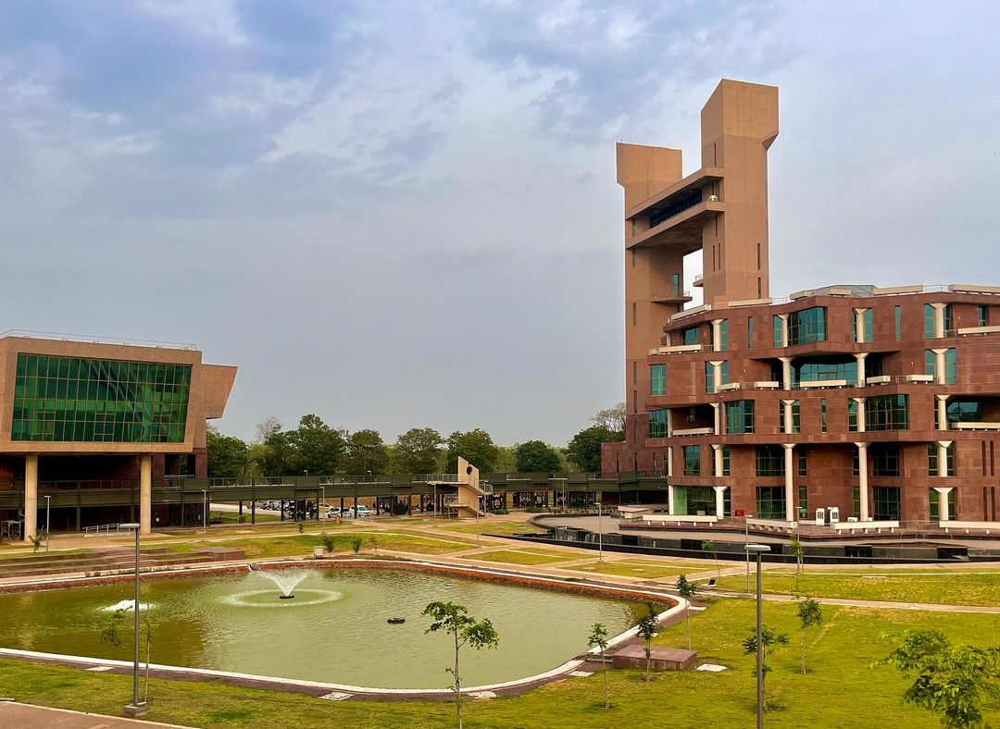

Generated Caption: a large building with a fountain and a large clock tower 
Translated Caption: ఫౌంటెన్ మరియు పెద్ద క్లాక్ టవర్తో కూడిన పెద్ద భవనం 


In [58]:
caption_translate_speech('/content/2.jpg','tel_Telu','ta')

### Example 2: `Hindi`

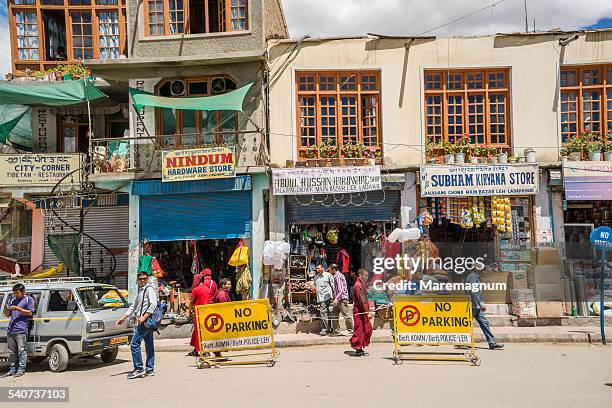

Generated Caption: a street scene with people walking and shopping 
Translated Caption: पैदल चलने और खरीदारी करने वाले लोगों के साथ एक सड़क दृश्य 


In [67]:
image='/content/8.jpg'
caption_translate_speech(image)

### Example 3: `Hindi`




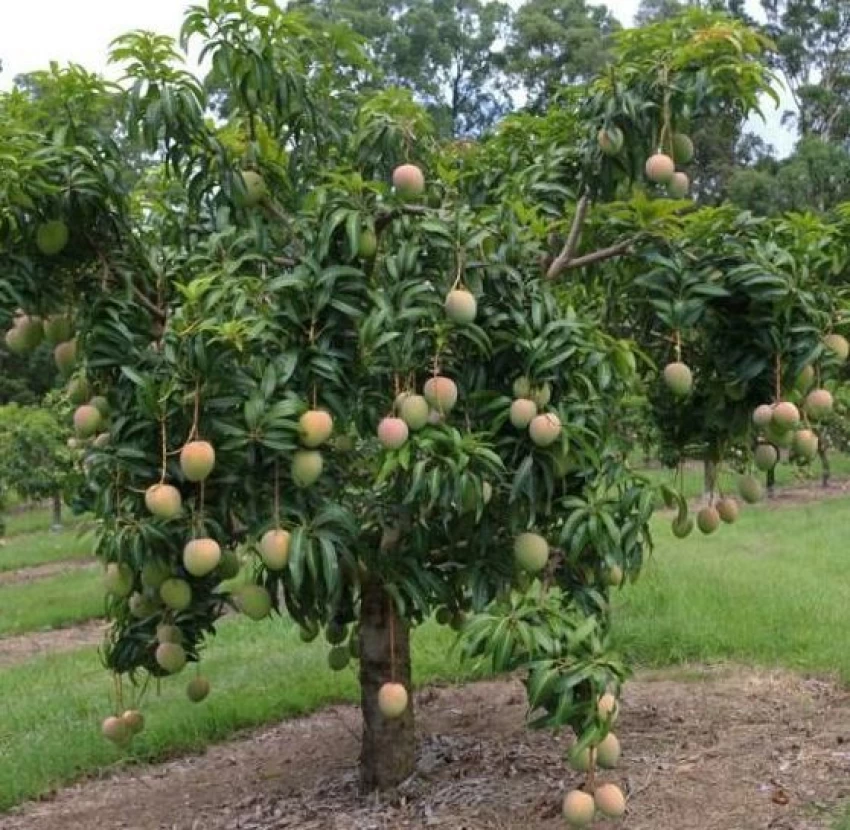

Generated Caption: a tree filled with lots of green and yellow fruit 
Translated Caption: बहुत सारे हरे और पीले फलों से भरा एक पेड़ 


In [56]:
image='/content/4.jpg'
caption_translate_speech(image)

### Example 4: `guj_Gujr`



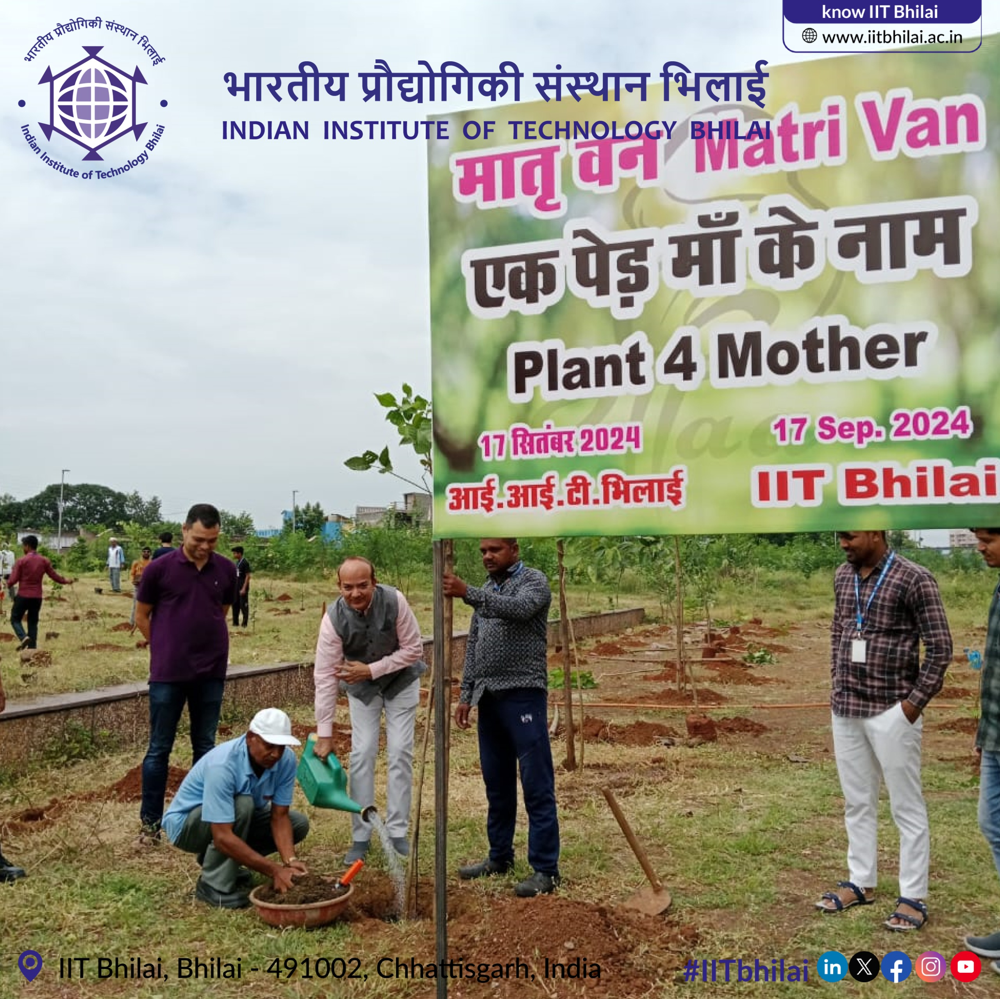

Generated Caption: people standing around a sign 
Translated Caption: નિશાનીની આસપાસ ઊભેલા લોકો 


In [62]:
image='/content/3.jpeg'
caption_translate_speech(image,'guj_Gujr','gu')

### Example 5: `Marathi`

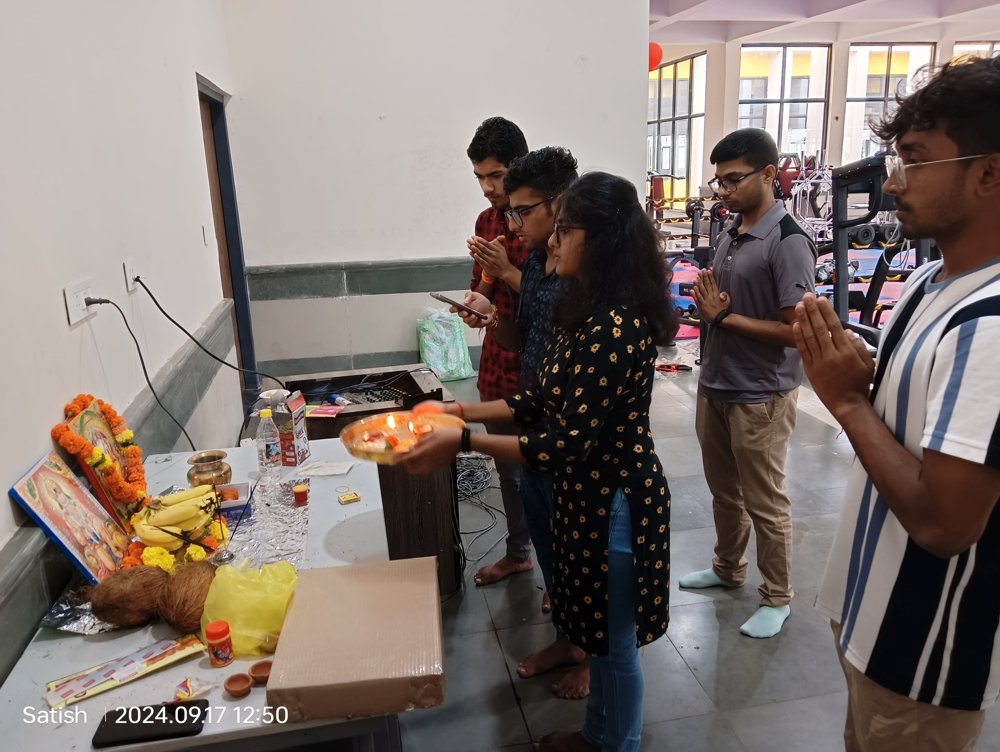

Generated Caption: people standing around a table with boxes of food 
Translated Caption: जेवणाचे डबे घेऊन टेबलाजवळ उभे असलेले लोक 


In [64]:
image='/content/1.jpg'
caption_translate_speech(image,'mar_Deva','mr')

### Example 6: `Bengali` `Inline code`

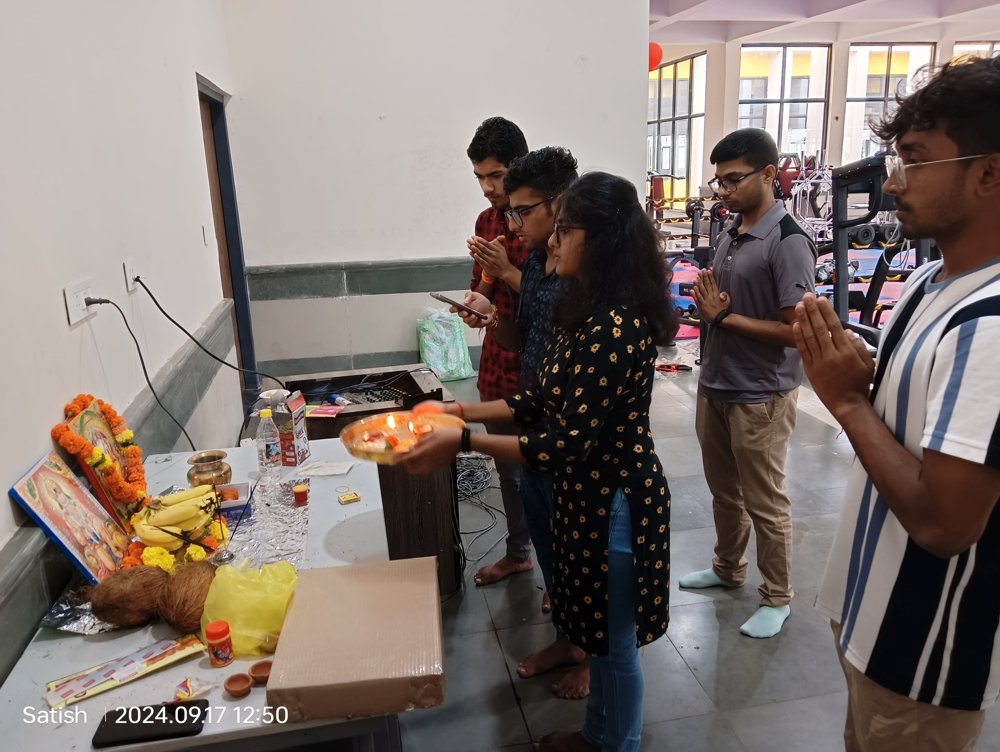

Generated Caption: people standing around a table with boxes of food 
Translated Caption: খাবারের বাক্স নিয়ে টেবিলের চারপাশে দাঁড়িয়ে থাকা লোকেরা 


In [53]:
image='/content/1.jpg'
caption_translate_speech(image,'ben_Beng','bn')

### Example 7: `Tamil`

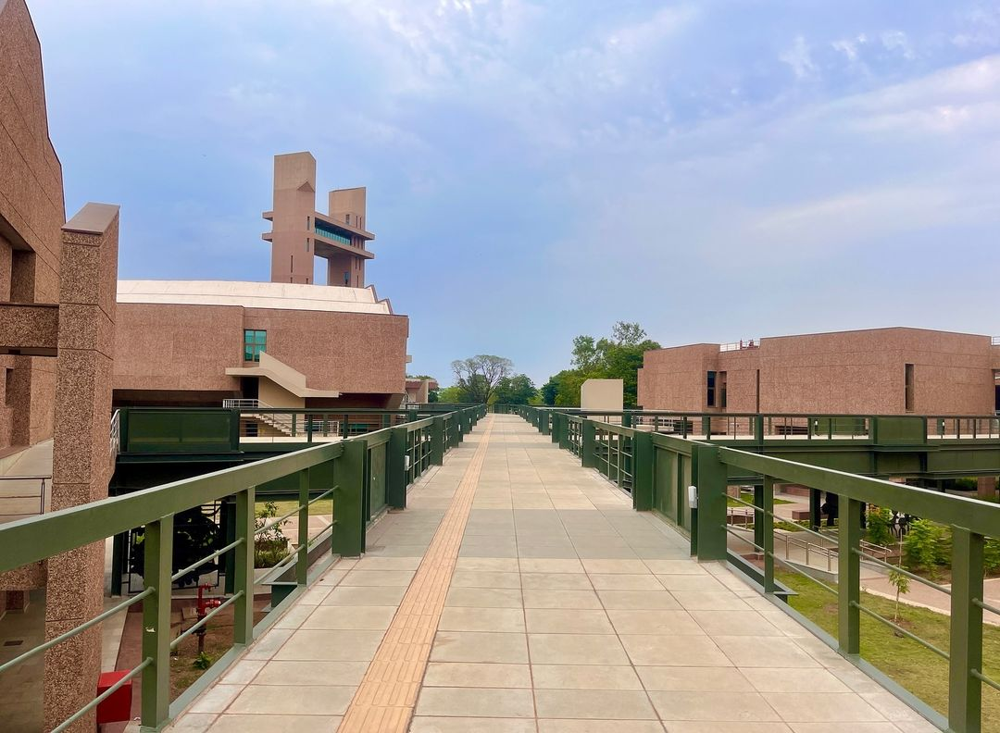

Generated Caption: a long walkway leading to a building with a fence 
Translated Caption: ஒரு வேலி கொண்ட ஒரு கட்டிடத்திற்கு வழிவகுக்கும் நீண்ட நடைபாதை 


In [60]:
image='/content/10.jpg'
caption_translate_speech(image,'tam_Taml','ta')

***